# Determining the Optimal Location for New Renewable Energy Sources in Puerto Rico

## Data Preparation
### Preprocess PR100 Data: 
Convert PR100 data into a grid format that matches the resolution of the wind and solar data. Each grid square will contain various features like habitat, infrastructure, etc.

### Preprocess Solar Data: 
Use the data from the Global Solar Atlas (https://globalsolaratlas.info/map) to generate features related to PV output for each grid square.

### Preprocess Wind Data: 
Similar to the solar data, convert wind data from the Global Wind Atlas (https://globalwindatlas.info/en) into grid format containing wind power potential for each square.

### Merge Datasets: 
Combine PR100, solar, and wind data such that each grid square has a feature vector containing all these details.

## CNN Architecture
### Input Layer: 
The input will be a feature map representing a section of the grid. Each channel in the feature map can correspond to different features (e.g., solar potential, wind speed, PR100 attributes).

### Convolutional Layers: 
Several layers to detect spatial features relevant to site suitability for energy installations.

### Output Layer: 
A feature map that the RL model can use for making decisions.

## Reinforcement Learning (DQN or PPO or A3C)
### State Representation: 
The current state of the environment, represented by the grid, and possibly the current installations.

### Action Space: 
Adding a new solar/wind installation to a particular grid square.

### Policy Network: 
#### Input: 
CNN output feature map (flattened or processed in some way).
#### Output: 
Probabilities for each action in the action space (e.g., placing a solar or wind installation on a particular grid square).

### Reward Function: 
Incorporates cluster and distribution rewards, as well as rewards based on energy output potential, costs, and PR100 attributes.

### Training: 
Use historical data to train the model to take actions that maximize the expected cumulative reward.

### Evaluation: 
Run the trained model in a simulated environment to evaluate its performance.

## Integration Steps
### Data Fusion: 
Use the CNN to transform the input grid data into a form that can be easily used by the RL model for decision-making.

### Decision Making: 
Use the RL model to decide where to place new installations based on the CNN's output and the current state of the grid.

### Reward Assessment: 
After each action, calculate the reward based on the new state of the grid, including any cluster and distribution considerations.

### Backpropagation: 
Use this reward signal to update both the RL and CNN models.

### Iteration: 
Continue this process, constantly updating the models based on the rewards received and the data observed.

## Output
### Optimized Grid: 
At the end of training, the model should be able to suggest an optimized grid configuration for renewable energy installations that takes into account spatial considerations, energy output, and PR100 constraints.

By systematically combining the spatial understanding from the CNN and the decision-making capabilities of RL, this integrated model aims to find the most optimal areas for renewable energy installations in Puerto Rico.

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import requests
import planetary_computer

from pyarrow.fs import PyFileSystem, FSSpecHandler, FileSelector
from adlfs import AzureBlobFileSystem

import geopandas

import rasterio.plot
from rasterio.io import MemoryFile
import io

## Accessing PR100 Data on Azure

In [2]:
# get a token with requests
token = requests.get(
    'https://planetarycomputer.microsoft.com/api/sas/v1/token/nrel/oedi'
).json()['token']

In [3]:
# get a token with planetary-computer
token = planetary_computer.sas.get_token('nrel', 'oedi').token

### Explore Container

Use the token to create a PyFileSystem object. You can explore the contents of the container using the get_file_info method. The PR100 data consists of geoparquet and geotiff files that are organized into directories:
- Boundaries
- Habitat
- Hazards
- Infrastructure
- Topography

In [4]:
# Create file system
fs = PyFileSystem(
    FSSpecHandler(
        AzureBlobFileSystem('nrel', credential=token)
    )
)

# View files in the 'Boundaries' directory
fs.get_file_info(FileSelector('/oedi/PR100/Boundaries/'))

[<FileInfo for 'oedi/PR100/Boundaries/coastal_zone_mgmt_act_boundary.parquet': type=FileType.File, size=220738>,
 <FileInfo for 'oedi/PR100/Boundaries/federal_and_state_waters.parquet': type=FileType.File, size=211866>,
 <FileInfo for 'oedi/PR100/Boundaries/land_protected_areas.parquet': type=FileType.File, size=10080885>]

### Load Vector Data

Let's load one of those files into a geodataframe and visualize it.

In [5]:
df = geopandas.read_parquet('oedi/PR100/Boundaries/land_protected_areas.parquet', filesystem=fs)
df.explore()

### Load Raster Data

If we look in the Topography directory, we'll see some tif files. These are cloud optimized GeoTiffs.

In [6]:
fs.get_file_info(FileSelector('/oedi/PR100/Topography/'))

[<FileInfo for 'oedi/PR100/Topography/bathymetry.tif': type=FileType.File, size=42549838>,
 <FileInfo for 'oedi/PR100/Topography/dist_to_shore.tif': type=FileType.File, size=80716048>,
 <FileInfo for 'oedi/PR100/Topography/elevation.tif': type=FileType.File, size=1821215>,
 <FileInfo for 'oedi/PR100/Topography/slope.tif': type=FileType.File, size=5623780>,
 <FileInfo for 'oedi/PR100/Topography/water_bodies.parquet': type=FileType.File, size=5460001>]

We can load these files with the rasterio package.

{'driver': 'GTiff', 'dtype': 'int16', 'nodata': 32767.0, 'width': 4827, 'height': 2085, 'count': 1, 'crs': CRS.from_epsg(32161), 'transform': Affine(99.99944200318302, 0.0, -3390.8897891612432,
       0.0, -99.99944200318302, 324418.85327119316)}


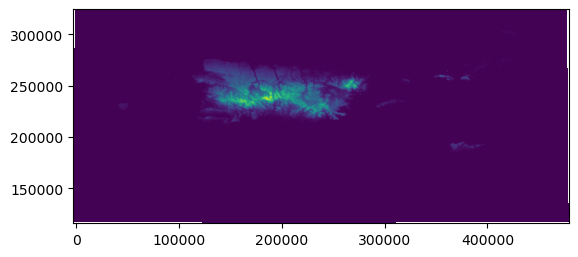

In [7]:
with fs.open_input_file('oedi/PR100/Topography/elevation.tif') as file:
    buffer = io.BytesIO(file.read())

with MemoryFile(buffer) as memfile:
    with memfile.open() as dataset:
        print(dataset.meta)
        rasterio.plot.show(dataset, adjust=True)


In [8]:
def show_gis_data(filepath, title, units):
    with rasterio.open(filepath) as src:
        # Read the first band (assuming it's a single-band raster)
        band1 = src.read(1)
        transform = src.transform
    
        # Get metadata if needed
        meta = src.meta
    
    # Generate coordinates for each pixel
    height, width = band1.shape
    x_coords, y_coords = np.meshgrid(
        np.arange(0, width),
        np.arange(0, height)
    )
    
    # Apply affine transformation to get lat, lon
    lon, lat = rasterio.transform.xy(transform, y_coords, x_coords)
    lon = np.array(lon)
    lat = np.array(lat)
    
    plt.figure(figsize=(12, 8))
    
    # Use imshow to plot the data array
    # Extent defines the left, right, bottom, top edges based on lon and lat
    plt.imshow(band1, extent=[lon.min(), lon.max(), lat.min(), lat.max()], origin='upper')
    
    # Add colorbar to interpret the values
    plt.colorbar(label=units)
    
    # Add labels and title
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.title(title)
    
    # Show plot
    plt.show()

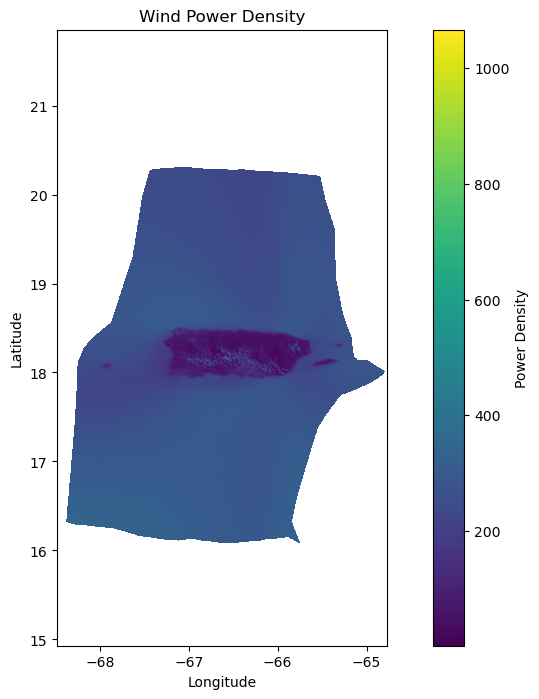

In [11]:
show_gis_data('../../data/wind_atlas/PRI_power-density_50m.tif', \
              'Wind Power Density', \
             'Power Density')

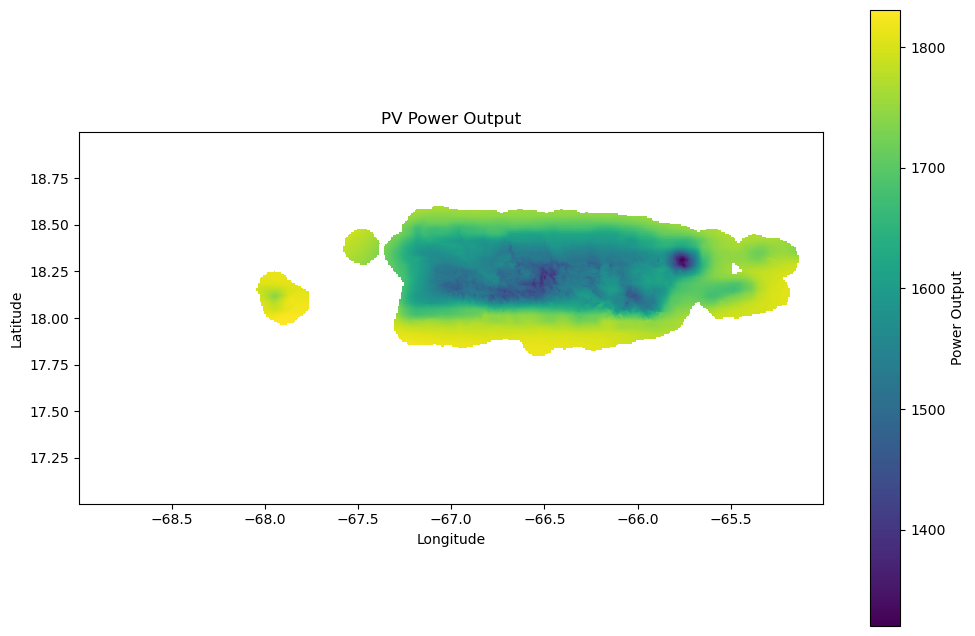

In [28]:
show_gis_data('../../data/solar_atlas/Yearly_PVOUT.tif', 'PV Power Output', 'Power Output')

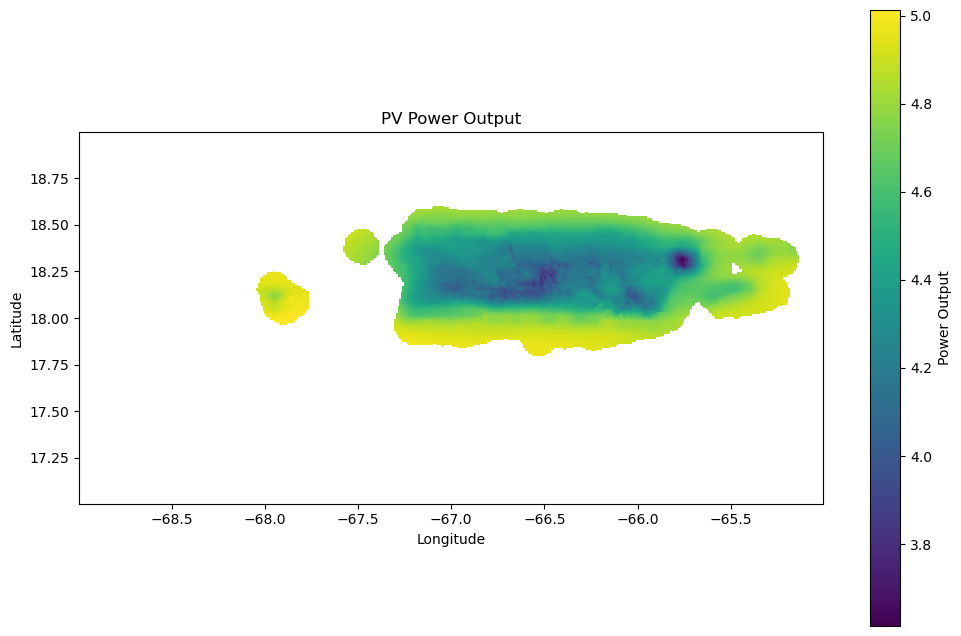

In [29]:
show_gis_data('../../data/solar_atlas/Daily_PVOUT.tif', 'PV Power Output', 'Power Output')